In [13]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import GridSpec
import matplotlib.gridspec as gridspec
import numpy as np
import glob
import pandas as pd
import math
import scipy as sp
from scipy.ndimage import gaussian_filter, binary_dilation, binary_erosion, binary_closing, binary_opening
from scipy.optimize import curve_fit

import skimage
import skimage.io
from skimage.morphology import disk
from skimage.filters import rank
from skimage import measure
from skimage.measure import regionprops, label

plt.style.use('styleNB.mplstyle')

# imaging pixel conversion
ip = 210.0/995.0 #995 pixels / 210 um interpixel distance

import cv2
from aicsimageio import AICSImage
from aicsimageio.writers import OmeTiffWriter

######################################
######################################
# Functions for segmentation
######################################
######################################

def generate_gradient_mask(image, threshold=50):
    """
    Generates a binary mask based on the gradient magnitude.

    Parameters:
        image (np.ndarray): The input 2D image.
        threshold (int): The threshold value for gradient magnitude.

    Returns:
        np.ndarray: The binary mask.
    """
    # Convert image to grayscale
    image = image.astype(np.float32)

    # Compute gradients using Sobel operator
    grad_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)

    # Threshold the gradient magnitude to generate the mask
    mask = (gradient_magnitude > threshold).astype(np.uint8)

    return mask


def smooth_mask_edges_morphological(mask, sigma=1.0, threshold=0.5, closing_iterations=1, opening_iterations=1):
    """
    Smooth the edges of a binary mask using Gaussian blurring followed by morphological closing and opening.
    
    Parameters:
    mask (np.ndarray): The input binary mask image.
    sigma (float): The standard deviation for Gaussian kernel. Higher values result in more smoothing.
    threshold (float): The threshold to convert the smoothed mask back to binary.
    closing_iterations (int): The number of iterations for the closing operation.
    opening_iterations (int): The number of iterations for the opening operation.
    
    Returns:
    np.ndarray: The smoothed binary mask image.
    """
    # Ensure the mask is binary (0 or 1)
    binary_mask = mask.astype(np.float32)
    
    # Apply Gaussian filter for smoothing
    smoothed_mask = gaussian_filter(binary_mask, sigma=sigma)
    
    # Normalize the smoothed mask to the range [0, 1]
    smoothed_mask = (smoothed_mask - smoothed_mask.min()) / (smoothed_mask.max() - smoothed_mask.min())
    
    # Apply threshold to convert back to binary mask
    smoothed_binary_mask = (smoothed_mask > threshold).astype(np.int32)
    
    # Apply morphological closing to smooth the edges
    closed_mask = binary_closing(smoothed_binary_mask, iterations=closing_iterations)
    
    # Apply morphological opening to further smooth the edges
    opened_mask = binary_opening(closed_mask, iterations=opening_iterations)
    
    return opened_mask.astype(np.int32)


######################################
######################################
# Functions for quantifying edge intensity
######################################
######################################

from shapely.geometry import LineString
from shapely.ops import unary_union

def mask_to_polygon(mask):
    """Converts a pixel mask into a line that outlines the edge."""
    # Find contours in the mask
    contours = measure.find_contours(mask, 0.5)

    # Select the longest contour
    contour = max(contours, key=len)

    # Convert the contour points to integer coordinates
    contour = np.round(contour).astype(int)

    # Filter out duplicate points from the contour
    unique_contour = []
    for point in contour:
        if len(unique_contour) == 0 or not np.array_equal(unique_contour[-1], point):
            unique_contour.append(point)

    return unique_contour

def polygon_to_line(mask):
    """Converts a pixel mask into an array of position values that outlines the edge."""
    # Convert mask to polygon
    line = mask_to_polygon(mask)
    line = LineString(line)

    # Find the centroid of the polygon
    centroid = line.centroid

    # Find the southmost point relative to the centroid (maximum y-coordinate)
    max_y = max(line.coords, key=lambda point: point[1])

    # Rotate the line so that the southmost point is the first point
    coords = list(line.coords)
    max_y_index = coords.index(max_y)
    rotated_coords = coords[max_y_index:] + coords[:max_y_index]

    line = LineString(rotated_coords)

    # Redraw line with equally spaced coords
    n = 301
    distances = np.linspace(0, line.length, n)
    points = [line.interpolate(distance) for distance in distances]
    new_line = LineString(points)
   
    return new_line

def cell_contour_intensity_max(new_line, im, cd_length = 15):
    # placeholder for intensity values
    vals = []

    # for each position in the edge line ('new_line'),
    for j in np.arange(300):
        # position j
        a = list(new_line.coords)[j] 
        # position j+1
        b = list(new_line.coords)[j + 1]
        # line from a to b
        ab = LineString([a, b])
        
        # define offset that is perpendicular to ab
        left = ab.parallel_offset(cd_length * 0.5, 'left')
        right = ab.parallel_offset(cd_length * 0.5, 'right')
        c = left.boundary.bounds[-2:]
        d = right.boundary.bounds[:2]  

        # line that runs perpendicular to edge between ab
        cd = LineString([c, d])

        # Generate line mask along cd
        n = 100
        distances_ = np.linspace(0, cd.length, n)
        points_ = [cd.interpolate(distance) for distance in distances_]
        mask = np.zeros(im.shape)
        for k in np.arange(len(points_)):
            mask[int(list(points_[k].coords)[0][1]), int(list(points_[k].coords)[0][0])] = 1
        
        # quantify intensity by multipying fluorescence image with line 'mask'
        vals_ = np.max(np.multiply(mask, im))
        vals = np.append(vals, vals_)
    
    return vals


def cell_contour_lines_visual(new_line, im, cd_length = 15):
    ''' 
    Similar to function cell_contour_intensity_max(), but
    it overlays all the individual lines for visualization of the
    quantified region.
        '''
    
    mask = np.zeros(im.shape)

    for j in np.arange(300):
        a = list(new_line.coords)[j]
        b = list(new_line.coords)[j + 1]

        ab = LineString([a, b])
        left = ab.parallel_offset(cd_length * 0.5, 'left')
        right = ab.parallel_offset(cd_length * 0.5, 'right')
        c = left.boundary.bounds[-2:]
        d = right.boundary.bounds[:2]  

        cd = LineString([c, d])

        # Generate line mask
        n = 100
        distances_ = np.linspace(0, cd.length, n)
        points_ = [cd.interpolate(distance) for distance in distances_]

        for k in np.arange(len(points_)):
            mask[int(list(points_[k].coords)[0][1]), int(list(points_[k].coords)[0][0])] = 1

    
    return  mask


######################################
######################################
# Functions for fitting
######################################
######################################
def model_func(t, A, K, C):
    return A * np.exp(K * t) + C    
    
def gaus(x,a,x0,sigma, e_ = 0):
    return a*np.exp(-(x-x0)**2/(2*sigma**2) + e_)

def linear(t, a, b):
    # S**2 = S2_ + 4Dt
    # b = 4D
    return a + b*t

# regular experiments - (non-latA treated, but identified non-motile cells)

## '../../data/microscopy/Amy/20240213_GalvGFP_1.2mA/20240213_GalvGFP_1.2mA_10/20240213_GalvGFP_1.2mA_10_MMStack_Pos0.ome.tif'

In [20]:
im_dir = glob.glob('../../data/microscopy/Amy/*/*/20240213_GalvGFP_1.2mA_10*.tif')
f = im_dir[0]

# load image (I'm using the original image file)
img = AICSImage(f)  
im = img.get_image_data("TCZYX") 
im_ph = im[:,0,0,:,:] # select phase image

im_mask = np.zeros_like(im_ph)
    
for i in np.arange(im_ph.shape[0]): #[:1]:
    # gradient of phase image, with threshold cutoff to identify cell boundaries 
    im_temp = generate_gradient_mask(im_ph[i,:,:], threshold=1100)

    # dilate to connect any discontinuities and fill holes
    bw = sp.ndimage.binary_dilation(im_temp, structure = np.ones((1,1)), iterations=1)
    bw = sp.ndimage.binary_fill_holes(bw)

    # erode a bit to shrink masks
    bw_mask = sp.ndimage.binary_erosion(bw, structure = np.ones((3,3)), iterations=2)

    # smooth_mask_edges
    im_mask[i,:,:] = smooth_mask_edges_morphological(bw_mask, 
                                                     sigma=3.0, 
                                                     threshold=0.5, 
                                                     closing_iterations=2, 
                                                     opening_iterations=2)
    


In [22]:
# Load in galvanin data again
im_dir = glob.glob('../../data/microscopy/Amy/*/*/20240213_GalvGFP_1.2mA_10*.tif')
im_dir = im_dir[0]

# Get an AICSImage object
img = AICSImage(im_dir)  # selects the first scene found
im = img.get_image_data("TCZYX") 
im_gfp = im[:,1,0,320:500,450:-320]

im_mask = im_mask[:,320:500,450:-320]

In [23]:
# identify only the cell of interest
im_mask_= np.zeros_like(im_mask)
for i in np.arange(im_mask.shape[0]):
    im_labeled, _ = skimage.measure.label(im_mask[i,:,:], background=0, return_num=True)
    im_labeled[im_labeled != 1] = 0
    im_mask_[i] = im_labeled 

estimate for D - max intensity!
0.133 μm^2/s


/var/folders/hs/8f67z23n6g9g9g4y03yhrn_c0000gn/T/ipykernel_10551/706492118.py:100: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax2 = plt.subplots(1, 2, figsize = (6, 3))


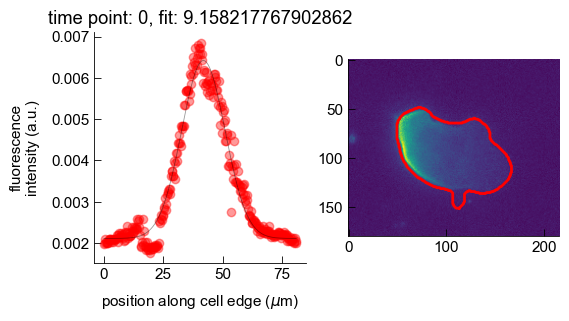

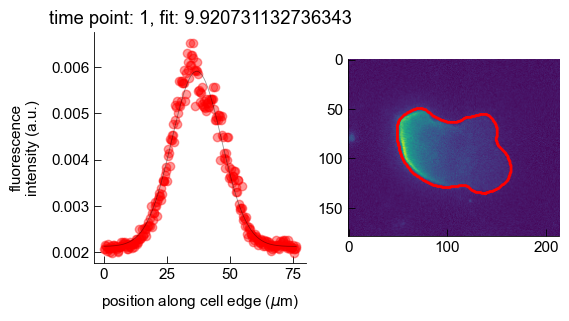

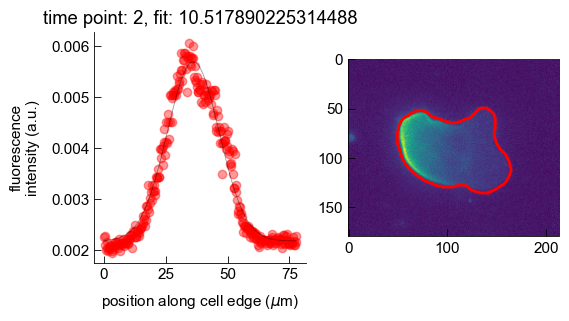

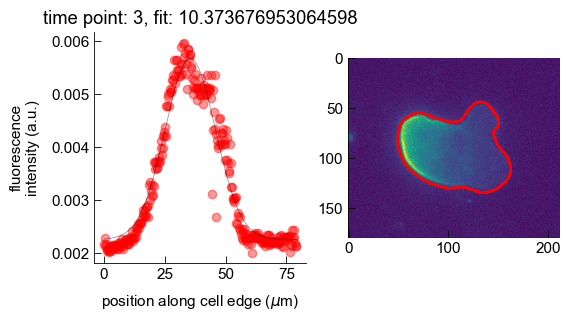

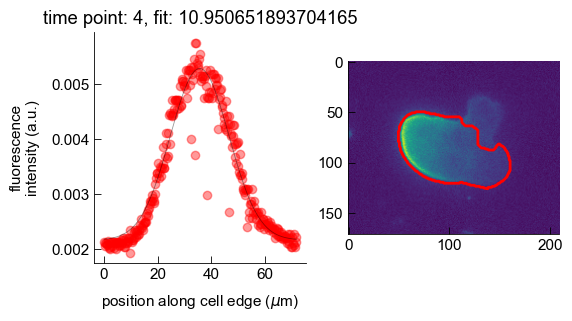

...

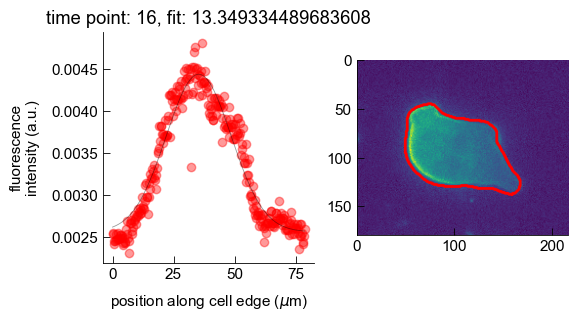

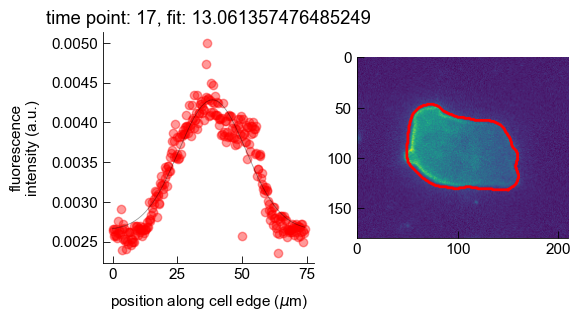

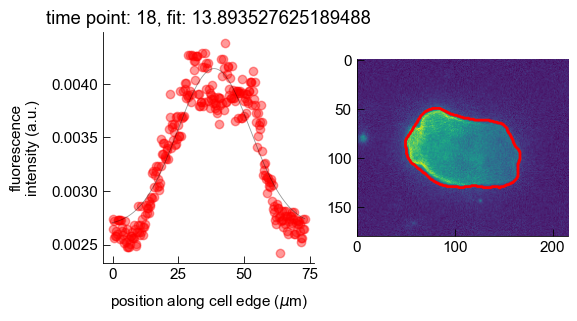

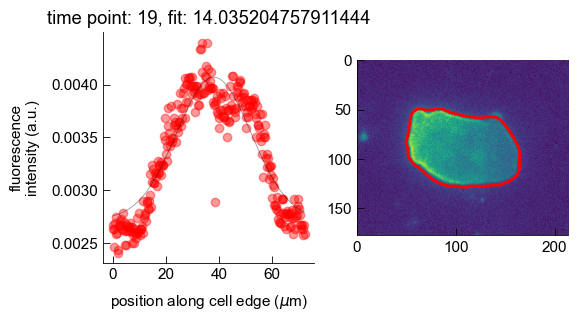

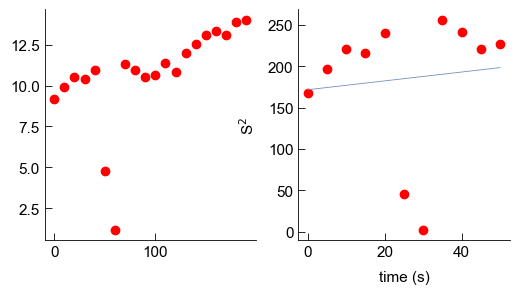

In [24]:
sigma = []

cd_length = 20
frames = np.arange(120,140)
fit_bound = [0,-1]

for count, i in enumerate(frames):
    # grab correct time frame
    im_m_ = im_mask_[i, :, :]

    #######
    # 2. Crop region of interest with some padding around cell (for both intensity image and mask)
    #######
    rows, cols = np.where(im_m_ == 1)
    pad = 50
    min_row, max_row = np.max([0,np.min(rows)-pad]), np.min([1024, np.max(rows)+pad])
    min_col, max_col = np.max([0,np.min(cols)-pad]), np.min([1024, np.max(cols)+pad])

    im_temp = im_gfp[i,min_row:max_row,min_col:max_col]
    im_m = im_m_[min_row:max_row,min_col:max_col]

    #######
    # 3. Quantify edge intensity
    #######

    # turn mask edge into a line
    new_line = polygon_to_line(im_m)
    new_line_length_pixels = new_line.length
    # quantify intensity along line (Note that the following 
    # function also performs a background subtraction using the average pixel
    # intensity in [x, y] region = [0:10,0:10])

    vals = cell_contour_intensity_max(new_line,im_temp.T, cd_length = cd_length) 

    # Convert to real micron units 
    # Since I split the edge into 300 posiitons, 
    # need to convert to pixels and then to micron.
    x = np.arange(len(vals))*(new_line_length_pixels/300)/(995/210)

    vals_renorm = vals/np.sum(vals)

    ####################
    # 4. Plot and fitting
    ####################
    fig, ax = plt.subplots(1,2, figsize=(6, 3))

    ax[0].plot(x, vals_renorm, 'ro',alpha = 0.4)
    ax[0].set_ylabel('fluorescence\nintensity (a.u.)')
    ax[0].set_xlabel(r'position along cell edge ($\mu$m)')

    ax[1].imshow(im_temp)

    # Find contours
    contours = measure.find_contours(im_m, level=0.5)

    # Plot each contour
    for contour in contours:
        ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')

    ##### Fitting
    y = vals_renorm

    # translate y values so minimum is zero, for fitting
    y_zero = np.mean(y[280:])
    y_temp = y - y_zero

    mean = x[150] # initial guess
    sigma_ = 20*0.14 # initial guess
    popt,pcov = curve_fit(gaus,x[fit_bound[0]:fit_bound[1]],
                           y_temp[fit_bound[0]:fit_bound[1]],
                          p0=[np.max(y_temp),mean,sigma_])

    sigma = np.append(sigma,popt[-1])

    ax[0].plot(x, gaus(x, *popt)+y_zero, alpha = 0.4, color='k')
    ax[0].set_title('time point: '+ str(count) + ', fit: ' + str(popt[-1]))

########## plots of S

f, ax2 = plt.subplots(1, 2, figsize = (6, 3))

ax2[0].plot(np.arange(10*len(sigma), step = 10), sigma, 'ro')

# consider early time points
sigma_um = sigma[:11]

# calculate sigma squared
sigma_um2 = sigma_um**2

S_um2 = 2*sigma_um2

# frame every 5 seconds 
# t = np.arange(5*len(sigma_um2), step = 5)
t = np.arange(5*len(S_um2), step = 5)

# fitting
a = 0 # initial estimate
b = 1.2 
# popt,pcov = curve_fit(linear,t,sigma_um2,p0=[a, b])
popt,pcov = curve_fit(linear,t,S_um2,p0=[a, b])

ax2[1].plot(t, S_um2, 'ro')
ax2[1].plot(t, linear(t, *popt))

ax2[1].set_ylabel(r'S$^{2}$')
ax2[1].set_xlabel('time (s)')

print('estimate for D - max intensity!')
print(f"{np.round(popt[1] / 4, 3)} μm^2/s")



In [33]:
t = np.arange(5*len(sigma), step = 5)
sigma_um = sigma

# calculate sigma squared
sigma_um2 = sigma_um**2

S_um2 = 2*sigma_um2

print(t)
print(S_um2)

[ 0  5 10 15 20 25 30 35 40 45 50 55 60 65 70 75 80 85 90 95]
[144.8521588  166.03887125 191.04421593 203.07688935 213.59155723
 230.08421829 257.85928757 269.56599176 287.14338492 283.86604132
 300.41108997 311.7360017  319.78124036 303.18140808 333.28516735
 351.44603034 317.45891996 328.2196039  370.49849197 386.95520825]


estimate for D - max intensity!
0.508 μm^2/s


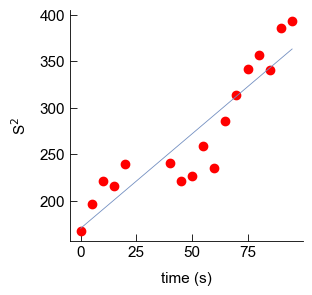

In [34]:
# remove erronerous time points due to poor segmentation

t_ = np.array([ 0,  5, 10, 15, 20,
                40, 45,
               50, 55, 60, 65, 70,
               75, 80, 85, 90, 95])
                             
S_um2_ = np.array([167.74590537, 196.84181242, 221.25202958, 215.22634705, 239.83355379,
                    240.91445567, 220.74705449,
                  226.45074093, 258.67935895, 234.60206933, 286.02148858, 313.57736011,
                  342.04708224, 356.40946263, 341.19811826, 386.06021974, 393.97394519])

f, ax2 = plt.subplots(1, 1, figsize = (3, 3))


a = 0 # initial estimate
b = 1.2 
popt,pcov = curve_fit(linear,t_,S_um2_,p0=[a, b])


ax2.plot(t_, S_um2_, 'ro')
ax2.plot(t_, linear(t_, *popt))

ax2.set_ylabel(r'S$^{2}$')
ax2.set_xlabel('time (s)')

print('estimate for D - max intensity!')
print(f"{np.round(popt[1] / 4, 3)} μm^2/s")

## '../../data/microscopy/Amy/20240213_GalvGFP_1.2mA/20240213_GalvGFP_1.2mA_10/20240213_GalvGFP_1.2mA_10_MMStack_Pos0.ome.tif'

In [46]:
im_dir = glob.glob('../../data/microscopy/Amy/*/*/20240213_GalvGFP_1.2mA_10*.tif')
f = im_dir[0]

# load image (I'm using the original image file)
img = AICSImage(f)  
im = img.get_image_data("TCZYX") 
im_ph = im[:,0,0,:,:] # select phase image

im_mask = np.zeros_like(im_ph)
    
for i in np.arange(im_ph.shape[0]): #[:1]:
    # gradient of phase image, with threshold cutoff to identify cell boundaries 
    im_temp = generate_gradient_mask(im_ph[i,:,:], threshold=1200)

    # dilate to connect any discontinuities and fill holes
    bw = sp.ndimage.binary_dilation(im_temp, structure = np.ones((1,1)), iterations=1)
    bw = sp.ndimage.binary_fill_holes(bw)

    # erode a bit to shrink masks
    bw_mask = sp.ndimage.binary_erosion(bw, structure = np.ones((3,3)), iterations=2)

    # smooth_mask_edges
    im_mask[i,:,:] = smooth_mask_edges_morphological(bw_mask, 
                                                     sigma=3.0, 
                                                     threshold=0.5, 
                                                     closing_iterations=2, 
                                                     opening_iterations=2)

estimate for D
0.554 μm^2/s


/var/folders/hs/8f67z23n6g9g9g4y03yhrn_c0000gn/T/ipykernel_10551/448738719.py:109: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax2 = plt.subplots(1, 2, figsize = (6, 3))


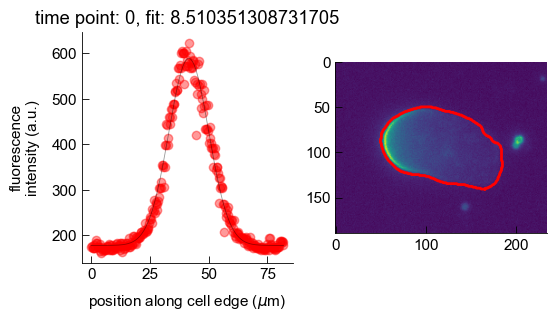

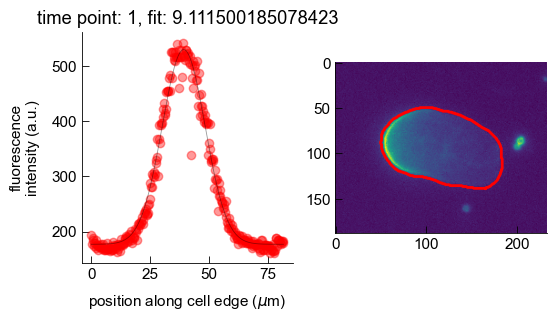

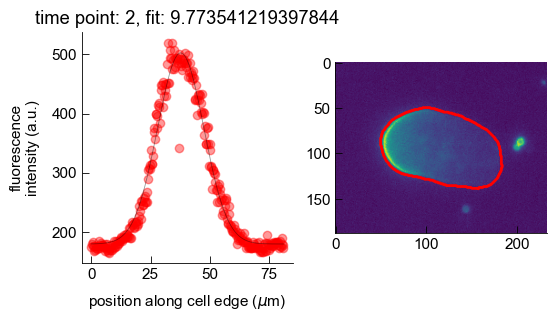

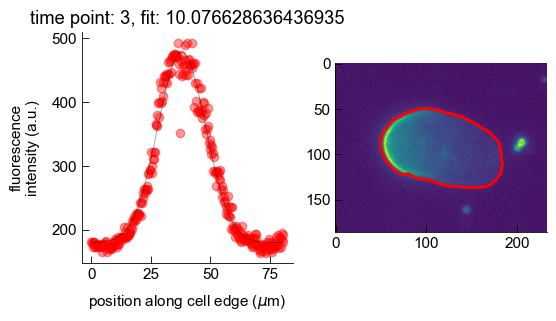

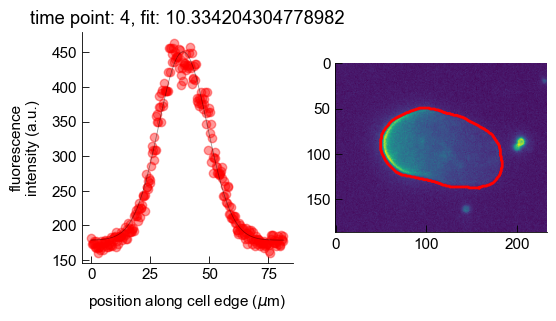

...

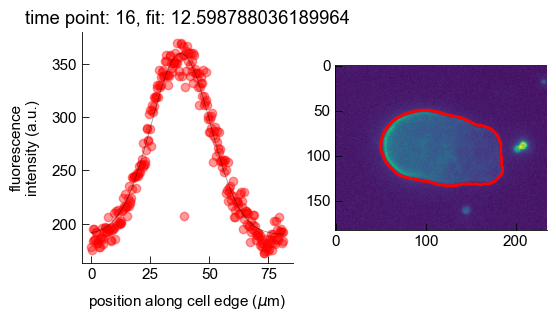

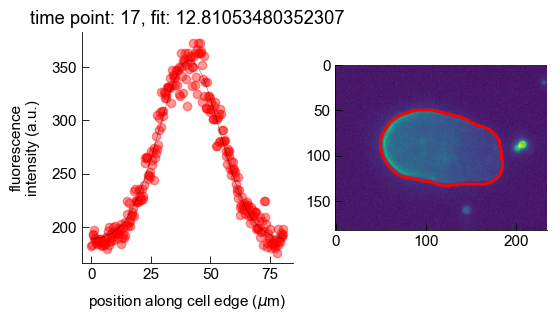

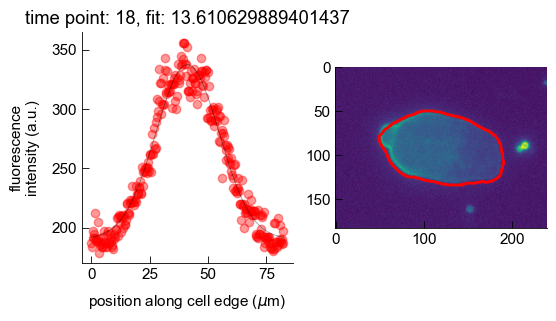

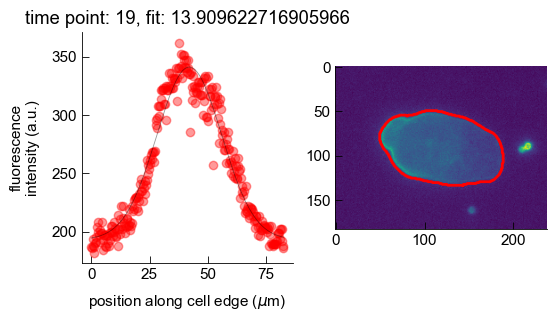

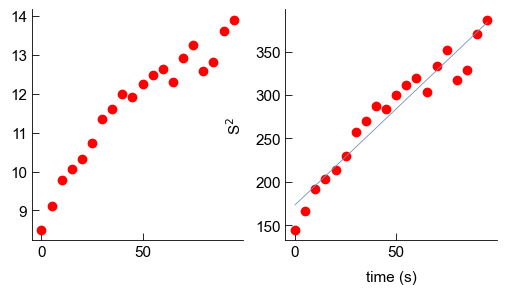

In [47]:
sigma = []

# Load in galvanin data
im_dir = glob.glob('../../data/microscopy/Amy/*/*/20240213_GalvGFP_1.2mA_10*.tif')
im_dir = im_dir[0]

# Get an AICSImage object
img = AICSImage(im_dir)  # selects the first scene found
im = img.get_image_data("TCZYX") 
im_gfp = im[:,1,0,:300,500:-200]

im_mask = im_mask[:,:300,500:-200]

cd_length = 20
frames = np.arange(120,140)


for count, i in enumerate(frames):
    # grab correct time frame
    im_m_ = im_mask[i, :, :]

    #######
    # 2. Crop region of interest with some padding around cell (for both intensity image and mask)
    #######
    rows, cols = np.where(im_m_ == 1)
    pad = 50
    min_row, max_row = np.max([0,np.min(rows)-pad]), np.min([1024, np.max(rows)+pad])
    min_col, max_col = np.max([0,np.min(cols)-pad]), np.min([1024, np.max(cols)+pad])

    im_temp = im_gfp[i,min_row:max_row,min_col:max_col]
    im_m = im_m_[min_row:max_row,min_col:max_col]

    #######
    # 3. Quantify edge intensity
    #######

    # turn mask edge into a line
    new_line = polygon_to_line(im_m)
    new_line_length_pixels = new_line.length
    # quantify intensity along line (Note that the following 
    # function also performs a background subtraction using the average pixel
    # intensity in [x, y] region = [0:10,0:10])

    vals = cell_contour_intensity_max(new_line,im_temp.T, cd_length = cd_length) 

    # Convert to real micron units 
    # Since I split the edge into 300 posiitons, 
    # need to convert to pixels and then to micron.
    x = np.arange(len(vals))*(new_line_length_pixels/300)/(995/210)

    vals_renorm = vals

    ####################
    # 4. Plot and fitting
    ####################
    fig, ax = plt.subplots(1,2, figsize=(6, 3))

    ax[0].plot(x, vals_renorm, 'ro',alpha = 0.4)
    ax[0].set_ylabel('fluorescence\nintensity (a.u.)')
    ax[0].set_xlabel(r'position along cell edge ($\mu$m)')


    ax[1].imshow(im_temp)

    # Find contours
    contours = measure.find_contours(im_m, level=0.5)

    # Plot each contour
    for contour in contours:
        ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')


    ##### Fitting
    y = vals_renorm

    # translate y values so minimum is zero, for fitting
    y_zero = np.mean(y[280:])
    y_temp = y - y_zero

    mean = x[150] # initial guess
    sigma_ = 20*0.14 # initial guess
    popt,pcov = curve_fit(gaus,x[fit_bound[0]:fit_bound[1]],
                           y_temp[fit_bound[0]:fit_bound[1]],
                          p0=[np.max(y_temp),mean,sigma_])

    sigma = np.append(sigma,popt[-1])

    ax[0].plot(x, gaus(x, *popt)+y_zero, alpha = 0.4, color='k')
    ax[0].set_title('time point: '+ str(count) + ', fit: ' + str(popt[-1]))



########## plots of S

f, ax2 = plt.subplots(1, 2, figsize = (6, 3))

ax2[0].plot(np.arange(5*len(sigma), step = 5), sigma, 'ro')

# consider early time points
sigma_um = sigma#[:11]

# calculate sigma squared
sigma_um2 = sigma_um**2
S_um2 = 2*sigma_um2

# frame every 5 seconds 
t = np.arange(5*len(S_um2), step = 5)

# fitting
a = 0 # initial estimate
b = 1.2 
popt,pcov = curve_fit(linear,t,S_um2,p0=[a, b])

ax2[1].plot(t, S_um2, 'ro')
ax2[1].plot(t, linear(t, *popt))

ax2[1].set_ylabel(r'S$^{2}$')
ax2[1].set_xlabel('time (s)')

print('estimate for D')
print(f"{np.round(popt[1] / 4, 3)} μm^2/s")




## '../../data/microscopy/Amy/20240416_HL60-GalvGFP-mAppleMLC/20240416_HL60-GalvGFP-mAppleMLC_1/20240416_HL60-GalvGFP-mAppleMLC_1_MMStack_Pos0.ome.tif'

In [48]:
# Load in galvanin data
im_dir = glob.glob('../../data/microscopy/Amy/*/*/20240416_HL60-GalvGFP-mAppleMLC_1_*.tif')
f = im_dir[0]

# load image (I'm using the original image file)
img = AICSImage(f)  
im = img.get_image_data("TCZYX") 
im_ph = im[:,0,0,:,:] # select phase image

im_mask = np.zeros_like(im_ph)
    
for i in np.arange(im_ph.shape[0]): #[:1]:
    # gradient of phase image, with threshold cutoff to identify cell boundaries 
    im_temp = generate_gradient_mask(im_ph[i,:,:], threshold=1200)

    # dilate to connect any discontinuities and fill holes
    bw = sp.ndimage.binary_dilation(im_temp, structure = np.ones((1,1)), iterations=1)
    bw = sp.ndimage.binary_fill_holes(bw)

    # erode a bit to shrink masks
    bw_mask = sp.ndimage.binary_erosion(bw, structure = np.ones((3,3)), iterations=2)

    # smooth_mask_edges
    im_mask[i,:,:] = smooth_mask_edges_morphological(bw_mask, 
                                                     sigma=3.0, 
                                                     threshold=0.5, 
                                                     closing_iterations=2, 
                                                     opening_iterations=2)

estimate for D - max intensity!
0.835 μm^2/s


/var/folders/hs/8f67z23n6g9g9g4y03yhrn_c0000gn/T/ipykernel_10551/1768275524.py:105: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax2 = plt.subplots(1, 2, figsize = (6, 3))


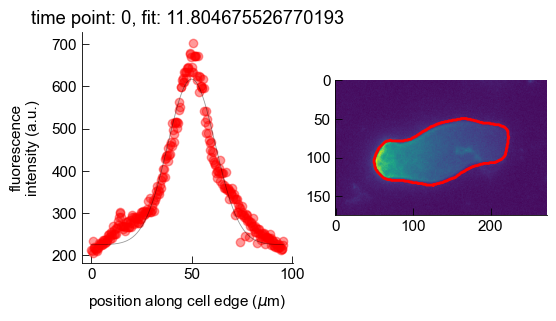

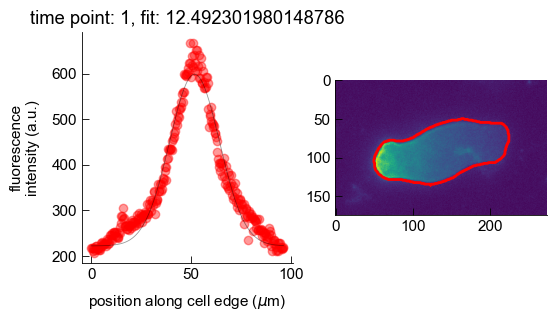

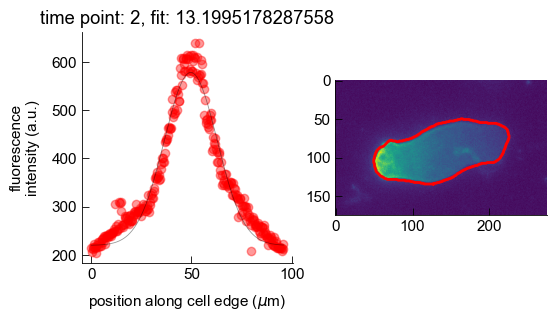

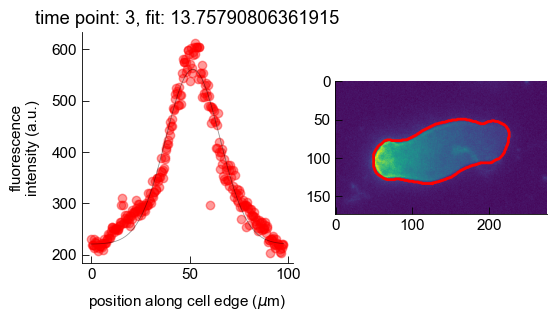

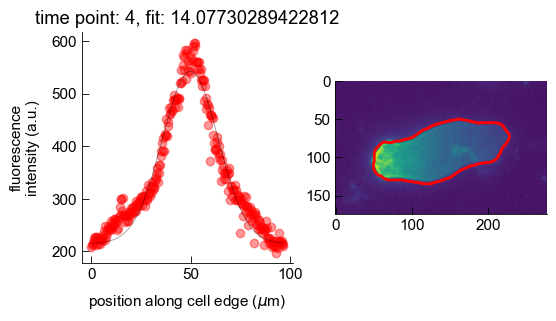

...

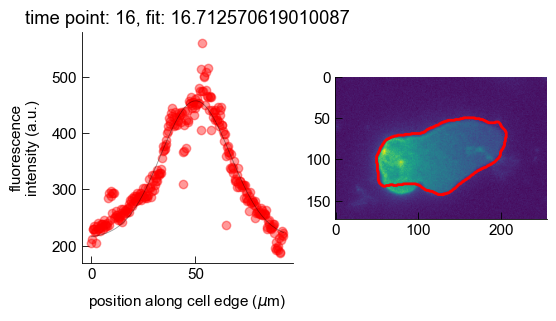

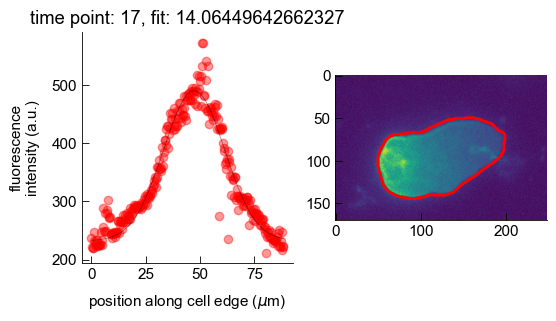

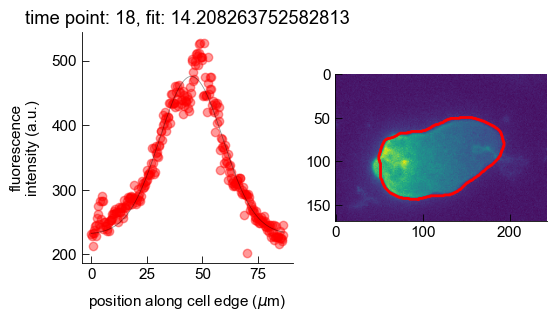

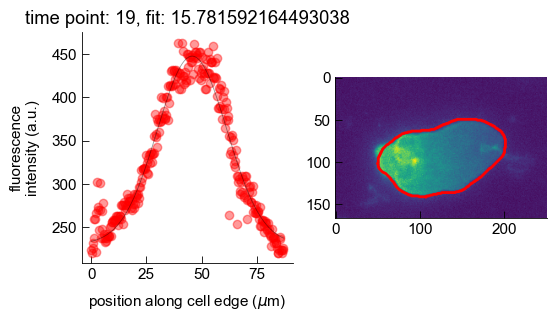

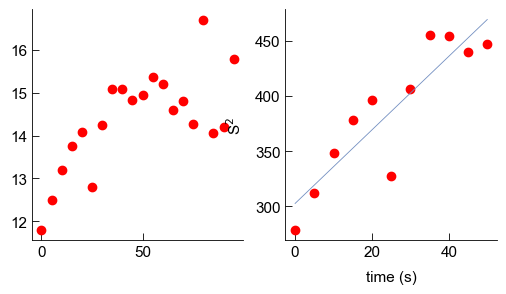

In [49]:
# Get an AICSImage object
img = AICSImage(f)  # selects the first scene found
im = img.get_image_data("TCYX") 
im_gfp = im[:,2,750:950, 450:780]

im_mask = im_mask[:,750:950, 450:780]

sigma = []

cd_length = 20
frames = np.arange(120,140)


for count, i in enumerate(frames):
    # grab correct time frame
    im_m_ = im_mask[i, :, :]

    #######
    # 2. Crop region of interest with some padding around cell (for both intensity image and mask)
    #######
    rows, cols = np.where(im_m_ == 1)
    pad = 50
    min_row, max_row = np.max([0,np.min(rows)-pad]), np.min([1024, np.max(rows)+pad])
    min_col, max_col = np.max([0,np.min(cols)-pad]), np.min([1024, np.max(cols)+pad])

    im_temp = im_gfp[i,min_row:max_row,min_col:max_col]
    im_m = im_m_[min_row:max_row,min_col:max_col]

    #######
    # 3. Quantify edge intensity
    #######

    # turn mask edge into a line
    new_line = polygon_to_line(im_m)
    new_line_length_pixels = new_line.length
    # quantify intensity along line (Note that the following 
    # function also performs a background subtraction using the average pixel
    # intensity in [x, y] region = [0:10,0:10])

    vals = cell_contour_intensity_max(new_line,im_temp.T, cd_length = cd_length) 

    # Convert to real micron units 
    # Since I split the edge into 300 posiitons, 
    # need to convert to pixels and then to micron.
    x = np.arange(len(vals))*(new_line_length_pixels/300)/(995/210)

    vals_renorm = vals

    ####################
    # 4. Plot and fitting
    ####################
    fig, ax = plt.subplots(1,2, figsize=(6, 3))

    ax[0].plot(x, vals_renorm, 'ro',alpha = 0.4)
    ax[0].set_ylabel('fluorescence\nintensity (a.u.)')
    ax[0].set_xlabel(r'position along cell edge ($\mu$m)')


    ax[1].imshow(im_temp)

    # Find contours
    contours = measure.find_contours(im_m, level=0.5)

    # Plot each contour
    for contour in contours:
        ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')



    ##### Fitting
    y = vals_renorm

    # translate y values so minimum is zero, for fitting
    y_zero = np.mean(y[280:])
    y_temp = y - y_zero

    # Fit step - note that I currently am taking the middle region 
    # i.e. for the 300 value y array, 75:225 

    mean = x[150] # initial guess
    sigma_ = 20*0.14 # initial guess
    popt,pcov = curve_fit(gaus,x[fit_bound[0]:fit_bound[1]],
                           y_temp[fit_bound[0]:fit_bound[1]],
                          p0=[np.max(y_temp),mean,sigma_])

    sigma = np.append(sigma,popt[-1])

    ax[0].plot(x, gaus(x, *popt)+y_zero, alpha = 0.4, color='k')

    #ax2.set_ylim(0,350)

    ax[0].set_title('time point: '+ str(count) + ', fit: ' + str(popt[-1]))



########## plots of S

f, ax2 = plt.subplots(1, 2, figsize = (6, 3))

ax2[0].plot(np.arange(5*len(sigma), step = 5), sigma, 'ro')

# consider early time points
sigma_um = sigma[:11]

# calculate sigma squared
sigma_um2 = sigma_um**2
S_um2 = 2*sigma_um2

# frame every 5 seconds 
t = np.arange(5*len(S_um2), step = 5)

# fitting
a = 0 # initial estimate
b = 1.2 
popt,pcov = curve_fit(linear,t,S_um2,p0=[a, b])

ax2[1].plot(t, S_um2, 'ro')
ax2[1].plot(t, linear(t, *popt))

ax2[1].set_ylabel(r'S$^{2}$')
ax2[1].set_xlabel('time (s)')

print('estimate for D')
print(f"{np.round(popt[1] / 4, 3)} μm^2/s")

# Latrunculin experiments

We're going to streamline the code a bit and generate a function to plug in the data.

In [67]:
files = ['../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_0.6mA_4/20240712_LatA_GalvGFP_0.6mA_4_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_0.6mA_3/20240712_LatA_GalvGFP_0.6mA_3_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_0.6mA_2/20240712_LatA_GalvGFP_0.6mA_2_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_1.2mA_1/20240712_LatA_GalvGFP_1.2mA_1_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_1.2mA_2/20240711_LatA_GalvGFP_1.2mA_2_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_1.2mA_1/20240711_LatA_GalvGFP_1.2mA_1_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_2.2mA_2/20240711_LatA_GalvGFP_2.2mA_2_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_2.2mA_3/20240712_LatA_GalvGFP_2.2mA_3_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_2.2mA_2/20240712_LatA_GalvGFP_2.2mA_2_MMStack_Pos0.ome.tif',
 '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_2.2mA_1/20240711_LatA_GalvGFP_2.2mA_1_MMStack_Pos0.ome.tif']

files_E = [1.5, 1.5, 1.5, 3, 3, 3, 5, 5, 5, 5]

dict_files_E = dict(zip(files, files_E))
dict_files_E

def analysis_identifyCells(f, threshold):
    df_cells = pd.DataFrame()

    # im_mask_ = np.empty((len(files), im_ph.shape[0], im_ph.shape[1], im_ph.shape[2]))
    im_mask_ = np.empty((151, 1024, 1024))

    ######################
    # Segmentation
    ######################

    # load image 
    img = AICSImage(f)  
    im = img.get_image_data("TCZYX") 
    im_ph = im[:,0,0,:,:] # select phase image
    im_gfp = im[:,1,0,:,:] 

    # placeholder for segmentation masks
    #im_mask = np.zeros_like(im_ph)

    # perform segmentation
    for i in np.arange(im_ph.shape[0]): #[:1]:
        # gradient of phase image, with threshold cutoff to identify cell boundaries 
        im_temp = generate_gradient_mask(im_ph[i,:,:], threshold=threshold)#600)

        # dilate to connect any discontinuities and fill holes
        bw = sp.ndimage.binary_dilation(im_temp, structure = np.ones((1,1)), iterations=1)
        bw = sp.ndimage.binary_fill_holes(bw)

        # erode a bit to shrink masks
        bw_mask = sp.ndimage.binary_erosion(bw, structure = np.ones((3,3)), iterations=2)

        # smooth_mask_edges
        im_mask_[i,:,:] = smooth_mask_edges_morphological(bw_mask, 
                                                         sigma=3.0, 
                                                         threshold=0.5, 
                                                         closing_iterations=2, 
                                                         opening_iterations=2)


    ######################
    # Identify cells to quantify
    ######################

    im_labeled, n_labels = skimage.measure.label(im_mask_[0,:,:], background=0, return_num=True)
    im_props = skimage.measure.regionprops(im_labeled)

    for L, prop in enumerate(im_props):

        # identify only the cells that have decent fluorescence
        im_labeled_temp = im_labeled.copy()
        im_labeled_temp[im_labeled_temp!=L+1] = 0

        # Only select objects that are big enough to be a cell and are fluorescent
        if np.all([prop.area >= 1000, np.mean(np.multiply(im_labeled_temp, im_gfp[0,:,:])) >=0.5]):

            datalist = {'cell' : L+1,
                        'centroid' : prop.centroid, 
                        'current' : f.split('mA')[0][-3:]+'mA',
                        'electric field' : dict_files_E[f],
                        'trial' : f.split('mA')[1][1],
                       'file' : f}

            df_cells = pd.concat([df_cells, pd.DataFrame([datalist])], ignore_index=True)
            
    return df_cells, im_mask_, im_gfp


def analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, cd_length = 10, fit_bound=[75,225], trunc = 11):          
    for g, d in df_cells.groupby(['current', 'trial']):
        print(g)

        # grab correct mask 
        im_mask = im_mask_
        print('Try using Max intensity!:')
        sigma = []

        for cell_val in d.cell.unique():
            if cell_val != cell:
                continue

            print(cell_val)
            
            for count, i in enumerate(frames):
                #######
                # 1. Identify cell in mask 
                #######

                im_labeled_0, _ = skimage.measure.label(im_mask[0,:,:], background=0, return_num=True)
                centroid_y = np.floor(d[d.cell == cell_val].centroid.values[0]).astype('int')[0]
                centroid_x = np.floor(d[d.cell == cell_val].centroid.values[0]).astype('int')[1]
                ind = im_labeled_0[centroid_y, centroid_x]
                im_labeled_0[im_labeled_0 != ind] = 0

                im_labeled, _ = skimage.measure.label(im_mask[i,:,:], background=0, return_num=True)

                if len(np.unique(np.multiply(im_labeled_0, im_labeled))) < 2:
                    continue
                ind_update = np.unique(np.multiply(im_labeled_0, im_labeled))[1]/ind


                im_labeled[im_labeled != ind_update] = 0
                im_labeled[im_labeled>0] = 1

                im_m = im_labeled


                #######
                # 2. Crop region of interest with some padding around cell (for both intensity image and mask)
                #######
                rows, cols = np.where(im_labeled == 1)
                pad = 50
                min_row, max_row = np.max([0,np.min(rows)-pad]), np.min([1024, np.max(rows)+pad])
                min_col, max_col = np.max([0,np.min(cols)-pad]), np.min([1024, np.max(cols)+pad])

                im_temp = im_gfp[i,min_row:max_row,min_col:max_col]
                im_m = im_m[min_row:max_row,min_col:max_col]

                #######
                # 3. Quantify edge intensity
                #######

                # turn mask edge into a line
                new_line = polygon_to_line(im_m)
                new_line_length_pixels = new_line.length
                # quantify intensity along line (Note that the following 
                # function also performs a background subtraction using the average pixel
                # intensity in [x, y] region = [0:10,0:10])
                
                vals = cell_contour_intensity_max(new_line,im_temp.T, cd_length = cd_length) 

                # Convert to real micron units 
                # Since I split the edge into 300 posiitons, 
                # need to convert to pixels and then to micron.
                x = np.arange(len(vals))*(new_line_length_pixels/300)/(995/210)

                vals_renorm = vals

                ####################
                # 4. Plot and fitting
                ####################
                fig, ax = plt.subplots(1,2, figsize=(6, 3))

                ax[0].plot(x, vals_renorm, 'ro',alpha = 0.4)
                ax[0].set_ylabel('fluorescence\nintensity (a.u.)')
                ax[0].set_xlabel(r'position along cell edge ($\mu$m)')

                
                ax[1].imshow(im_temp)

                # Find contours
                contours = measure.find_contours(im_m, level=0.5)

                # Plot each contour
                for contour in contours:
                    ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')
                    
                ##### Fitting
                y = vals_renorm

                # translate y values so minimum is zero, for fitting
                y_zero = np.mean(y[280:])
                y_temp = y - y_zero

                # Fit step - note that I currently am taking the middle region 
                # i.e. for the 300 value y array, 75:225 

                mean = x[150] # initial guess
                sigma_ = 20*0.14 # initial guess
                popt,pcov = curve_fit(gaus,x[fit_bound[0]:fit_bound[1]],
                                       y_temp[fit_bound[0]:fit_bound[1]],
                                      p0=[np.max(y_temp),mean,sigma_])

                sigma = np.append(sigma,popt[-1])
                
                ax[0].plot(x, gaus(x, *popt)+y_zero, alpha = 0.4, color='k')

                #ax2.set_ylim(0,350)

                ax[0].set_title('time point: '+ str(count) + ', fit: ' + str(popt[-1]))
                
                
            ########## plots of S

            f, ax2 = plt.subplots(1, 2, figsize = (6, 3))

            ax2[0].plot(np.arange(10*len(sigma), step = 10), sigma, 'ro')


            # consider early time points
            sigma_um = sigma[:trunc]

            # calculate sigma squared
            sigma_um2 = sigma_um**2
            S_um2 = 2*sigma_um2

            # frame every 10 seconds 
            t = np.arange(10*len(S_um2), step = 10)

            # fitting:
            a = 0 # initial estimate
            b = 1.2 
            popt,pcov = curve_fit(linear,t,S_um2,p0=[a, b])


            ax2[1].plot(t, S_um2, 'ro')
            ax2[1].plot(t, linear(t, *popt))

            ax2[1].set_ylabel(r'S$^{2}$')
            ax2[1].set_xlabel('time (s)')

            print('estimate for D')
            print(f"{np.round(popt[1] / 4, 3)} μm^2/s")

  

In [ ]:
# Segmentation threshold values
# files 0,1,2,3, 7, 8 -> threshold = 300
# files 4, 5, 6, 9 : 600

## '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_1.2mA_1/20240712_LatA_GalvGFP_1.2mA_1_MMStack_Pos0.ome.tif'

In [57]:
f = files[4]
threshold = 600

df_cells, im_mask_, im_gfp = analysis_identifyCells(f, threshold)


In [58]:
df_cells.cell.unique()

array([ 1,  3,  4,  5,  8, 11, 12, 13, 14, 15, 16, 17, 18])

('1.2mA', '2')
Try using Max intensity!:
11


/var/folders/hs/8f67z23n6g9g9g4y03yhrn_c0000gn/T/ipykernel_10551/762995031.py:165: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1,2, figsize=(6, 3))


estimate for D
0.223 μm^2/s


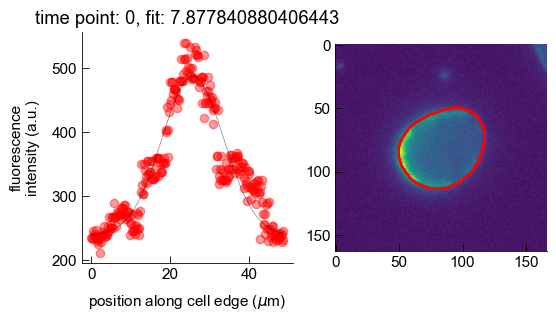

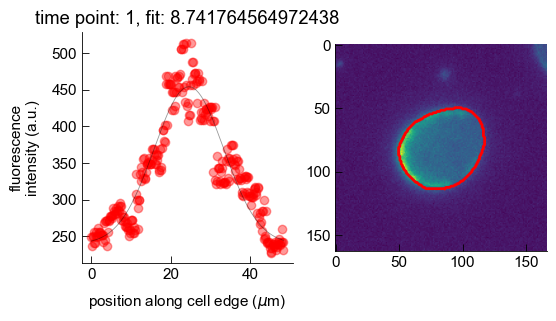

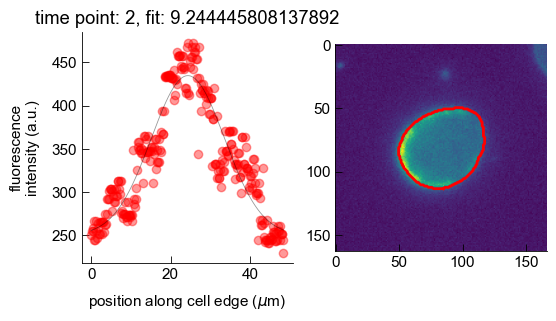

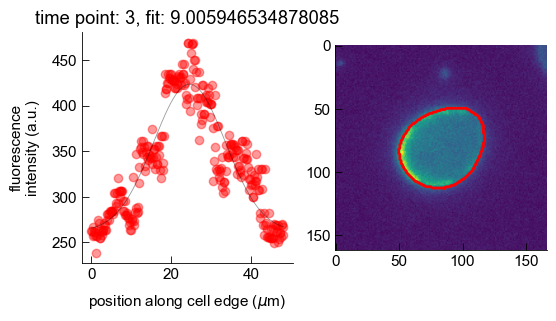

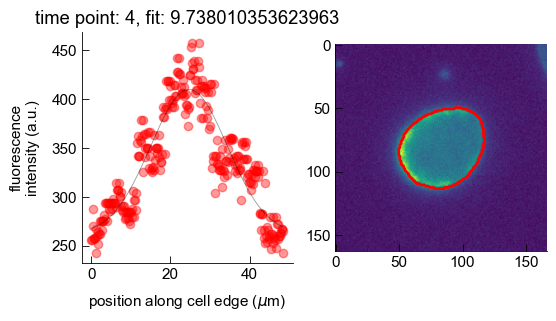

...

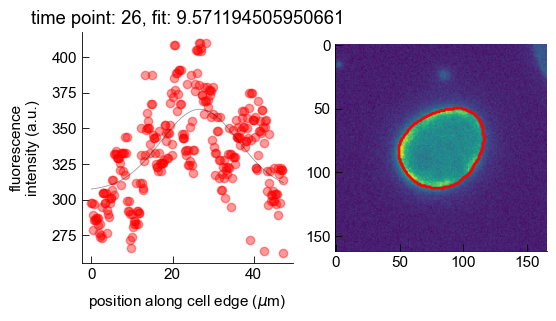

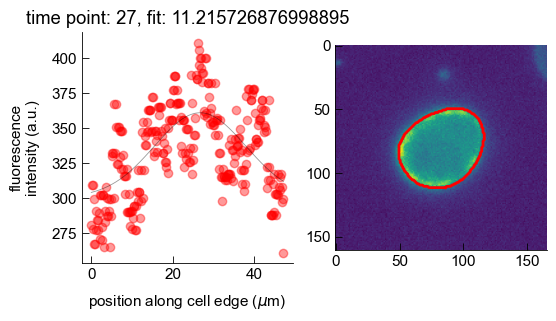

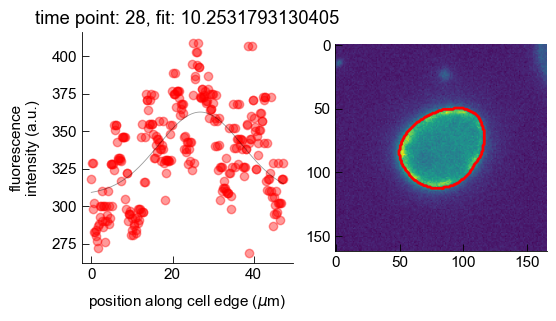

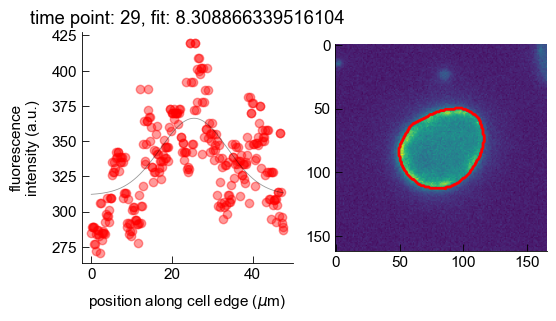

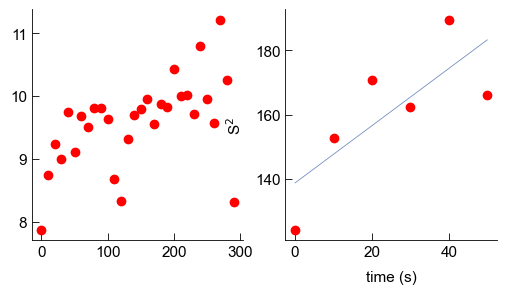

In [59]:
# [ 1,  3,  4,  5,  8, 11, 12, 13, 14, 15, 16, 17, 18]
cell = 11

frames = np.arange(90,120)

fit_bound = [0,-1]# [50, 250]

analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, 15, fit_bound, 6)


('1.2mA', '2')
Try using Max intensity!:
15
estimate for D
0.371 μm^2/s


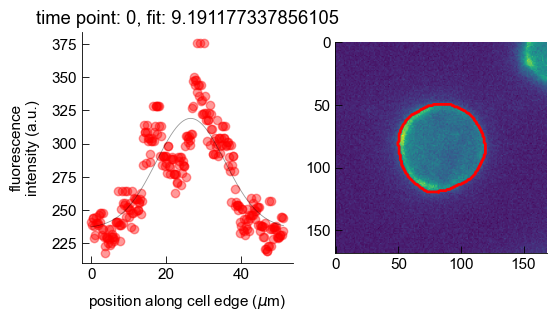

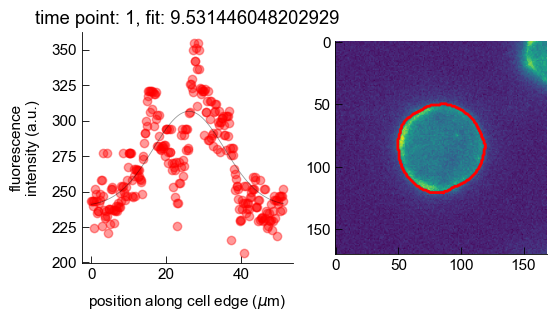

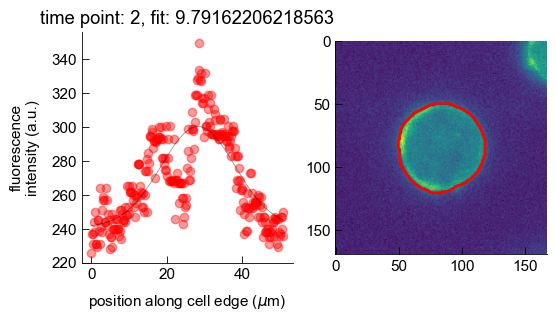

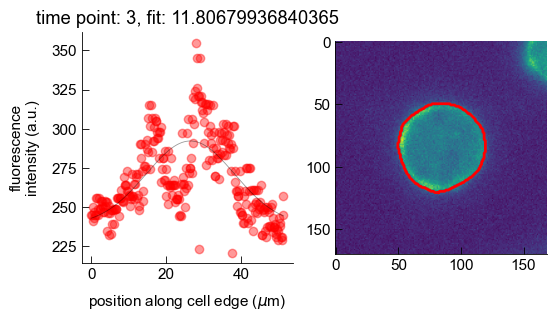

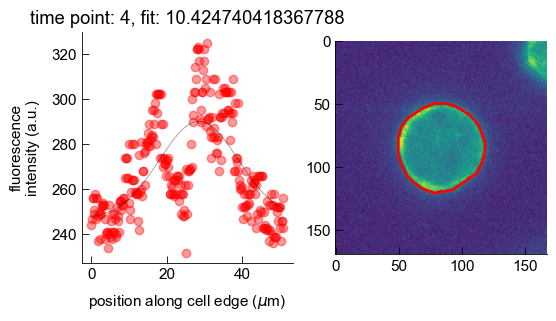

...

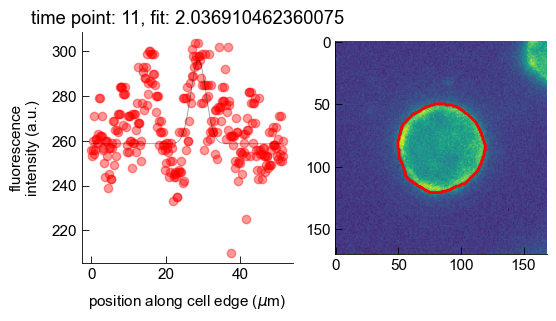

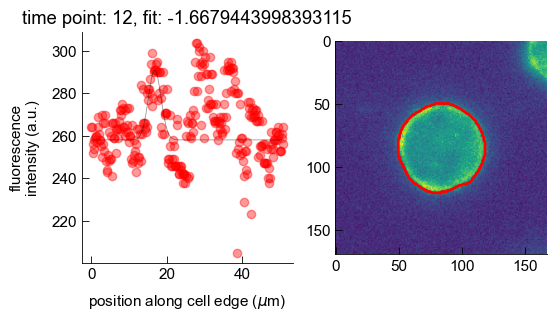

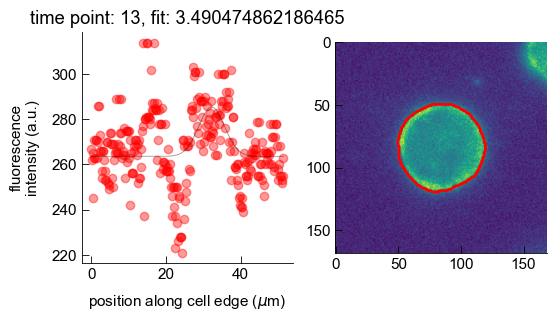

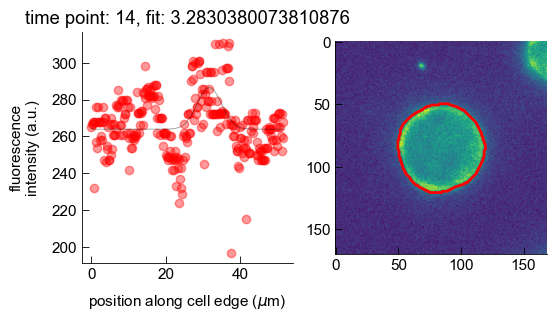

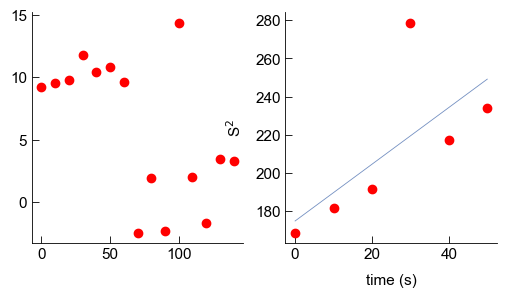

In [60]:
cell = 15

frames = np.arange(90,105)

fit_bound = [0,-1]# [50, 250]

analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, 15, fit_bound, 7)



## '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_2.2mA_2/20240711_LatA_GalvGFP_2.2mA_2_MMStack_Pos0.ome.tif'

In [62]:
f = files[6]
threshold = 650

df_cells, im_mask_, im_gfp = analysis_identifyCells(f, threshold)
df_cells

,cell,centroid,current,electric field,trial,file
0,2,"(106.51470236672245, 223.45565383695913)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
1,3,"(189.1520889690412, 452.35287045386235)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
2,4,"(243.35867446393763, 790.2744993797626)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
3,6,"(310.4087866108787, 189.41046025104603)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
4,8,"(381.62264150943395, 438.6605917667238)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
5,10,"(427.77391066045493, 906.4845163058372)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
6,17,"(870.1916602907421, 76.47704667176741)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
7,18,"(916.8840422649688, 763.625033866161)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
8,19,"(928.9176694110197, 248.94553514882838)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...
9,20,"(944.3290893993911, 984.480487129809)",2.2mA,5,2,../../data/microscopy/Amy/20240711_LatA/202407...


In [63]:
df_cells.cell.unique()

array([ 2,  3,  4,  6,  8, 10, 17, 18, 19, 20])

('2.2mA', '2')
Try using Max intensity!:
4
estimate for D
0.534 μm^2/s


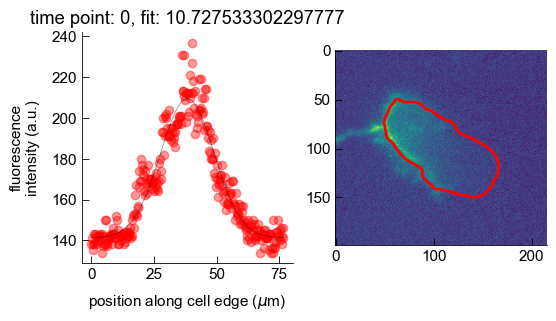

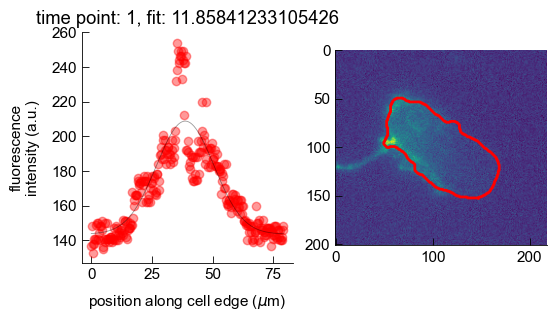

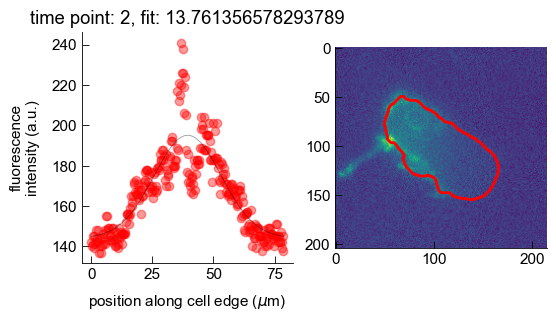

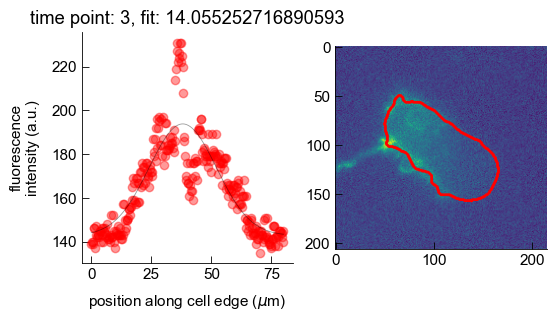

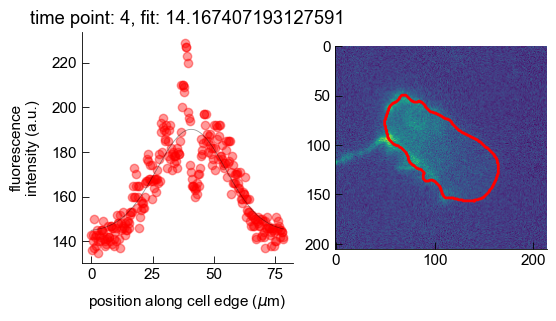

...

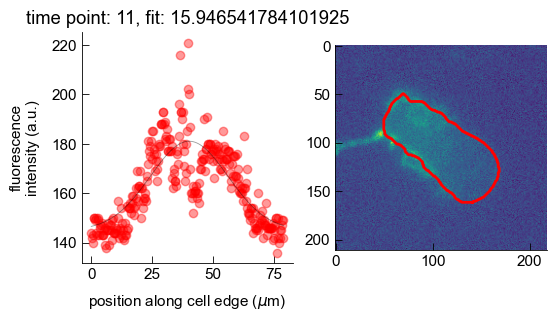

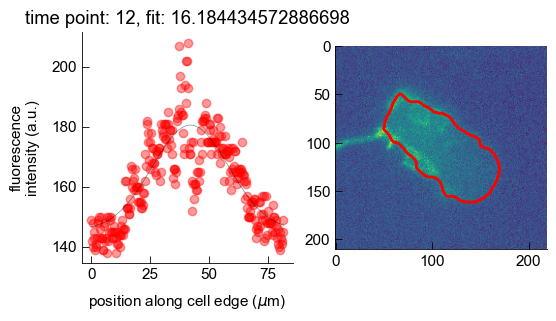

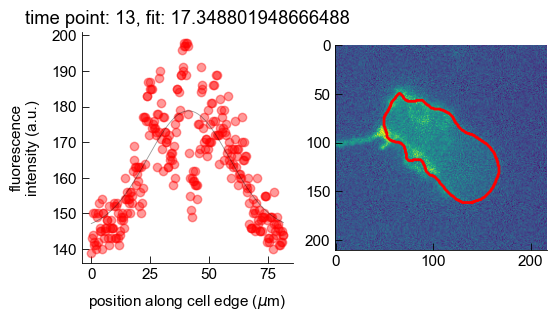

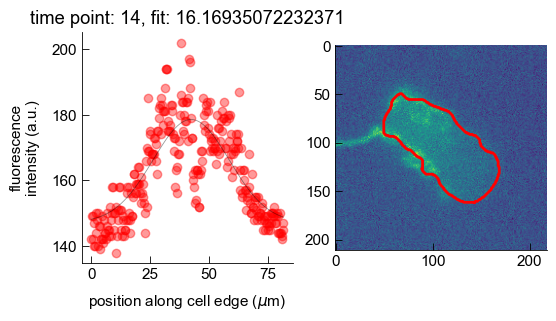

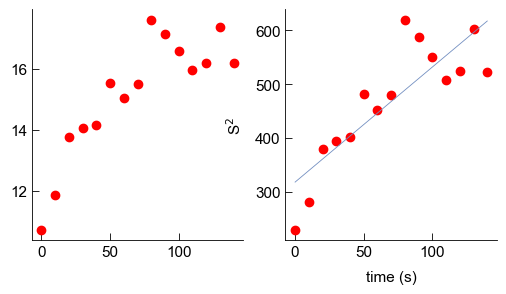

In [68]:
# # # [ 2,  3,  4,  6,  8,  9, 15, 16, 17, 18]
cell = 4

frames = np.arange(90,105)

fit_bound = [0,-1]# [50, 250]

analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, 14, fit_bound, 15)



## '../../data/microscopy/Amy/20240712_LatA/20240712_LatA_GalvGFP_2.2mA_2/20240712_LatA_GalvGFP_2.2mA_2_MMStack_Pos0.ome.tif'

In [77]:
f = files[8]
threshold = 500

df_cells, im_mask_, im_gfp = analysis_identifyCells(f, threshold)
df_cells

<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read '20240712_LatA_GalvGFP_1.2mA_2_MMStack_Pos0.ome.tif'. Missing data are zeroed
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read 302 files
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read '20240712_LatA_GalvGFP_1.2mA_2_MMStack_Pos0.ome.tif'. Missing data are zeroed
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read 302 files


,cell,centroid,current,electric field,trial,file
0,2,"(143.86900958466452, 673.3282215122471)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
1,4,"(225.32787641226653, 915.6324648374452)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
2,7,"(422.5870481259703, 427.03437569305834)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
3,13,"(671.8933708567855, 338.6707317073171)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
4,16,"(771.4347365634101, 370.18824463860204)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
5,17,"(844.0151515151515, 887.0053310886644)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
6,18,"(912.5952472211575, 147.49214258336528)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...


In [72]:
print(df_cells.cell.unique())

[ 2  4  7 13 16 17 18]


('2.2mA', '2')
Try using Max intensity!:
2
estimate for D
0.764 μm^2/s


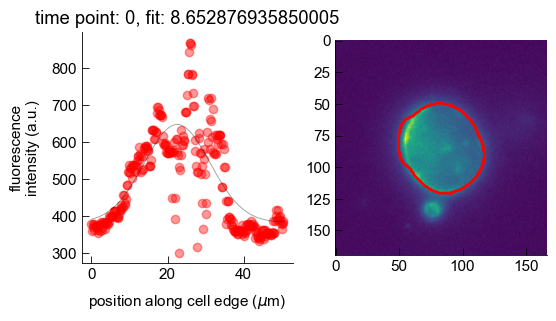

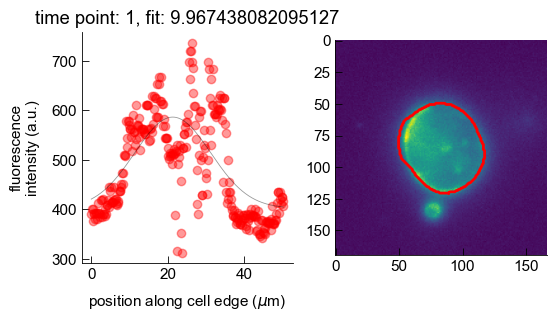

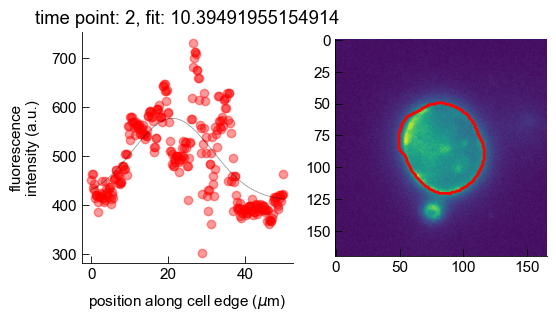

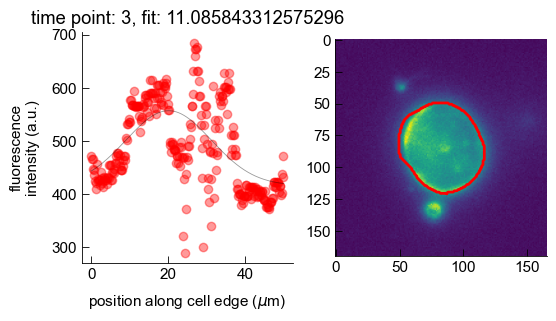

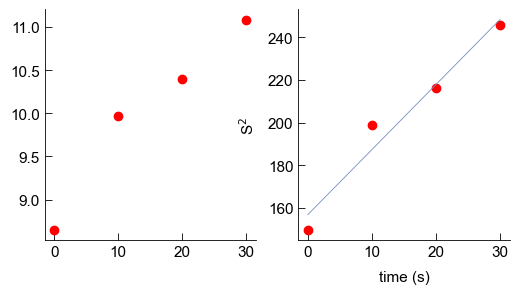

In [79]:
cell = 2

frames = np.arange(90,94)

fit_bound = [0,-1]# [50, 250]

analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, 10, fit_bound, 11)



In [80]:
# Different threshold for one cell due to segmentation issues

f = files[8]
threshold = 300

df_cells, im_mask_, im_gfp = analysis_identifyCells(f, threshold)
df_cells

<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read '20240712_LatA_GalvGFP_1.2mA_2_MMStack_Pos0.ome.tif'. Missing data are zeroed
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read 302 files
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read '20240712_LatA_GalvGFP_1.2mA_2_MMStack_Pos0.ome.tif'. Missing data are zeroed
<tifffile.TiffFile '20240712_LatA_Ga…ck_Pos0.ome.tif'> OME series failed to read 302 files


,cell,centroid,current,electric field,trial,file
0,2,"(102.1540027137042, 475.5393487109905)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
1,3,"(144.87895142636853, 674.8552428681572)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
2,4,"(125.42353883106485, 739.3899119295436)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
3,5,"(226.24680938657883, 913.8458213256484)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
4,6,"(324.5074148296593, 520.423246492986)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
5,7,"(344.1974025974026, 19.365367965367966)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
6,8,"(422.8726061615321, 426.87239800166526)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
7,10,"(526.6734265734266, 1009.3909090909091)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
8,12,"(638.2366878358573, 756.1069858329263)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...
9,13,"(669.5988965517241, 338.8198620689655)",2.2mA,5,2,../../data/microscopy/Amy/20240712_LatA/202407...


('2.2mA', '2')
Try using Max intensity!:
5
estimate for D
1.029 μm^2/s


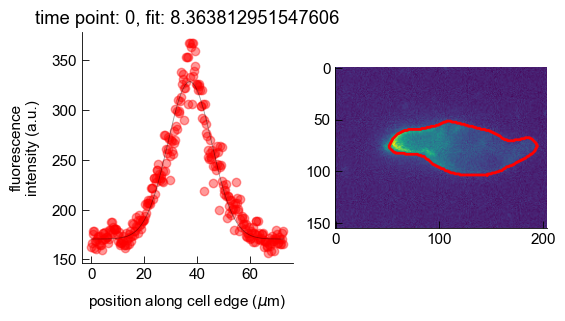

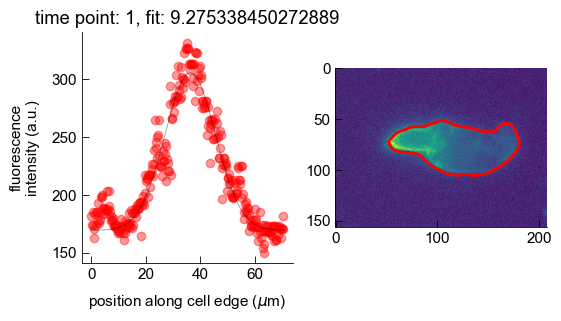

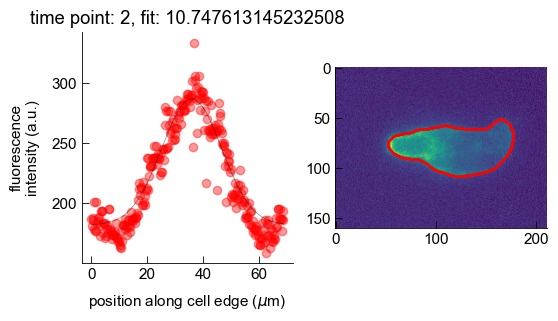

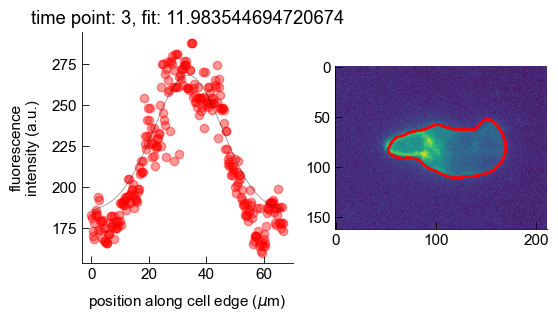

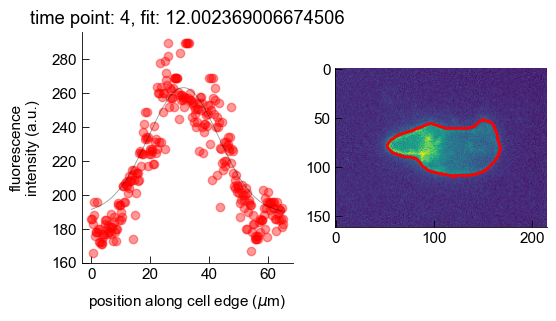

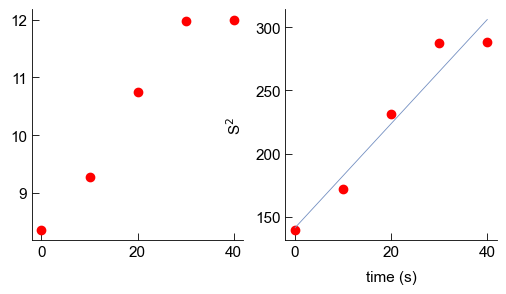

In [92]:

cell = 5

frames = np.arange(90,95)

fit_bound = [0,-1]

cd_length = 10
fit_bound=[75,225]



for g, d in df_cells.groupby(['current', 'trial']):
    print(g)

    im_mask = im_mask_
    print('Try using Max intensity!:')
    sigma = []

    for cell_val in d.cell.unique():
        if cell_val != cell:
            continue

        print(cell_val)

        for count, i in enumerate(frames):
            #######
            # 1. Identify cell in mask 
            #######

            im_labeled_0, _ = skimage.measure.label(im_mask[0,:,:], background=0, return_num=True)
            centroid_y = np.floor(d[d.cell == cell_val].centroid.values[0]).astype('int')[0]
            centroid_x = np.floor(d[d.cell == cell_val].centroid.values[0]).astype('int')[1]
            ind = im_labeled_0[centroid_y, centroid_x]
            im_labeled_0[im_labeled_0 != ind] = 0

            im_labeled, _ = skimage.measure.label(im_mask[i,:,:], background=0, return_num=True)

            if len(np.unique(np.multiply(im_labeled_0, im_labeled))) < 2:
                continue
            ind_update = np.unique(np.multiply(im_labeled_0, im_labeled))[1]/ind


            im_labeled[im_labeled != ind_update] = 0
            im_labeled[im_labeled>0] = 1

            im_m = im_labeled
            
            im_m = sp.ndimage.binary_erosion(im_m, structure = np.ones((3,3)), iterations=2)


            #######
            # 2. Crop region of interest with some padding around cell (for both intensity image and mask)
            #######
            rows, cols = np.where(im_labeled == 1)
            pad = 50
            min_row, max_row = np.max([0,np.min(rows)-pad]), np.min([1024, np.max(rows)+pad])
            min_col, max_col = np.max([0,np.min(cols)-pad]), np.min([1024, np.max(cols)+pad])

            im_temp = im_gfp[i,min_row:max_row,min_col:max_col]
            im_m = im_m[min_row:max_row,min_col:max_col]

            #######
            # 3. Quantify edge intensity
            #######

            # turn mask edge into a line
            new_line = polygon_to_line(im_m)
            new_line_length_pixels = new_line.length
            # quantify intensity along line (Note that the following 
            # function also performs a background subtraction using the average pixel
            # intensity in [x, y] region = [0:10,0:10])

            vals = cell_contour_intensity_max(new_line,im_temp.T, cd_length = cd_length) 

            # Convert to real micron units 
            # Since I split the edge into 300 posiitons, 
            # need to convert to pixels and then to micron.
            x = np.arange(len(vals))*(new_line_length_pixels/300)/(995/210)

            vals_renorm = vals

            ####################
            # 4. Plot and fitting
            ####################
            fig, ax = plt.subplots(1,2, figsize=(6, 3))

            ax[0].plot(x, vals_renorm, 'ro',alpha = 0.4)
            ax[0].set_ylabel('fluorescence\nintensity (a.u.)')
            ax[0].set_xlabel(r'position along cell edge ($\mu$m)')


            ax[1].imshow(im_temp)

            # Find contours
            contours = measure.find_contours(im_m, level=0.5)

            # Plot each contour
            for contour in contours:
                ax[1].plot(contour[:, 1], contour[:, 0], linewidth=2, color='red')



            ##### Fitting
            y = vals_renorm

            # translate y values so minimum is zero, for fitting
            y_zero = np.mean(y[280:])
            y_temp = y - y_zero

            # Fit step - note that I currently am taking the middle region 
            # i.e. for the 300 value y array, 75:225 

            mean = x[150] # initial guess
            sigma_ = 20*0.14 # initial guess
            popt,pcov = curve_fit(gaus,x[fit_bound[0]:fit_bound[1]],
                                   y_temp[fit_bound[0]:fit_bound[1]],
                                  p0=[np.max(y_temp),mean,sigma_])

            sigma = np.append(sigma,popt[-1])

            ax[0].plot(x, gaus(x, *popt)+y_zero, alpha = 0.4, color='k')

            #ax2.set_ylim(0,350)

            ax[0].set_title('time point: '+ str(count) + ', fit: ' + str(popt[-1]))



        ########## plots of S

        f, ax2 = plt.subplots(1, 2, figsize = (6, 3))

        ax2[0].plot(np.arange(10*len(sigma), step = 10), sigma, 'ro')


        # consider early time points
        sigma_um = sigma

        # calculate sigma squared
        sigma_um2 = sigma_um**2
        S_um2 = 2*sigma_um2

        # frame every 10 seconds 
        t = np.arange(10*len(S_um2), step = 10)


        a = 0 # initial estimate
        b = 1.2 
        popt,pcov = curve_fit(linear,t,S_um2,p0=[a, b])


        ax2[1].plot(t, S_um2, 'ro')
        ax2[1].plot(t, linear(t, *popt))

        ax2[1].set_ylabel(r'S$^{2}$')
        ax2[1].set_xlabel('time (s)')

        print('estimate for D')
        print(f"{np.round(popt[1] / 4, 3)} μm^2/s")


## '../../data/microscopy/Amy/20240711_LatA/20240711_LatA_GalvGFP_2.2mA_1/20240711_LatA_GalvGFP_2.2mA_1_MMStack_Pos0.ome.tif'

In [93]:
f = files[9]
threshold = 600

df_cells, im_mask_, im_gfp = analysis_identifyCells(f, threshold)
df_cells

,cell,centroid,current,electric field,trial,file
0,1,"(131.00342195314556, 894.132929718347)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
1,3,"(229.33752093802346, 591.1289782244556)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
2,4,"(238.8331065759637, 306.6176870748299)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
3,11,"(480.9277914758718, 295.9580838323353)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
4,12,"(496.62252794496993, 677.9739180280883)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
5,13,"(604.132281205165, 880.0398852223816)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
6,16,"(679.0781045751634, 119.75588235294117)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
7,17,"(739.0672162333544, 466.2160219826675)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
8,18,"(714.272465851905, 593.5226455787204)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...
9,20,"(845.1234256926953, 380.0579345088161)",2.2mA,5,1,../../data/microscopy/Amy/20240711_LatA/202407...


In [94]:
df_cells.cell.unique()

array([ 1,  3,  4, 11, 12, 13, 16, 17, 18, 20, 21])

('2.2mA', '1')
Try using Max intensity!:
1
estimate for D
0.309 μm^2/s


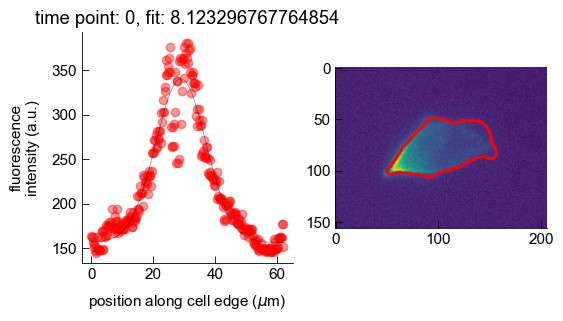

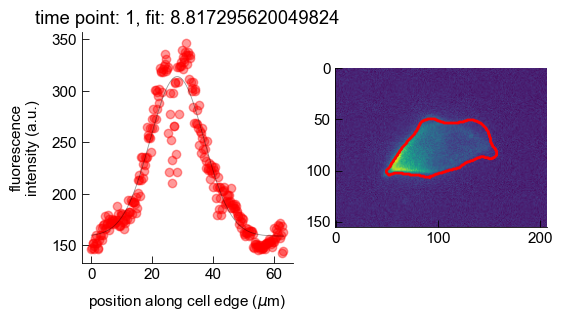

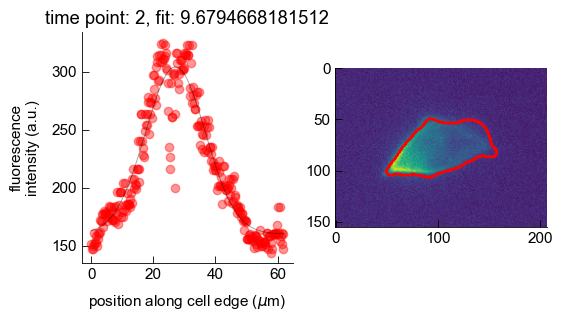

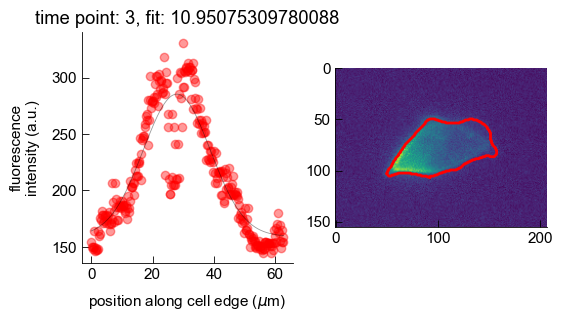

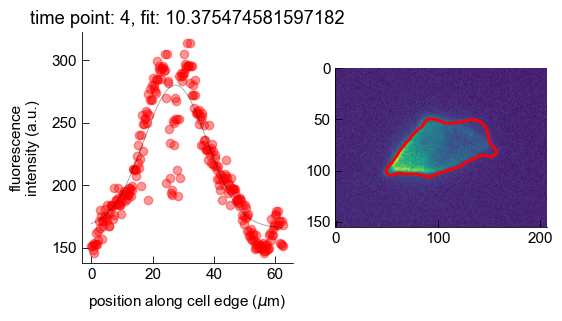

...

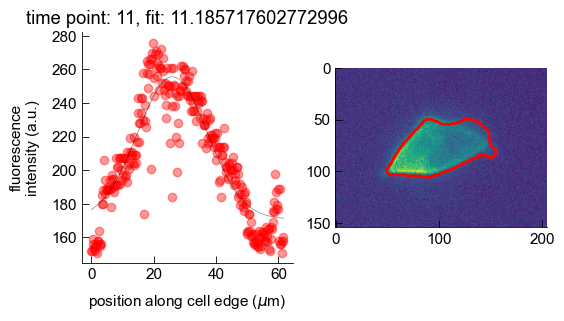

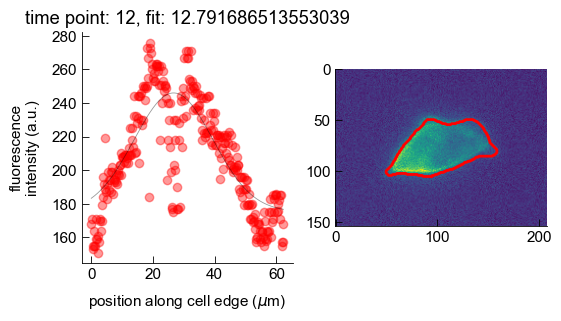

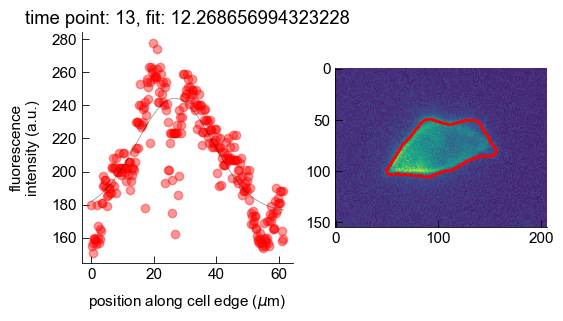

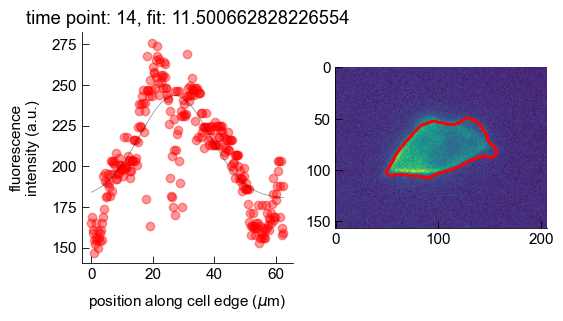

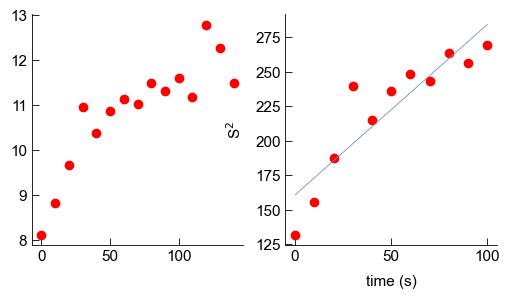

In [95]:
# [ 1,  3,  4, 11, 12, 13, 16, 17, 18, 20, 21]
cell = 1

frames = np.arange(90,105)

fit_bound = [0,-1]# [50, 250]

analysis_fcn(im_gfp, im_mask_, df_cells, cell, frames, 15, fit_bound)

# Summary


In [97]:
D_untreat = [0.133, 0.508, 0.554, 0.835]
D_lat = [0.223, 0.371, 0.534 , 0.764, 1.029, 0.309]

In [98]:
D_combined = np.append(D_untreat, D_lat)

In [99]:
sp.stats.sem(D_combined)

0.08967087970275894

In [100]:
np.mean(D_combined)

0.526